# Module 03 - Clustering
## Sample Purification
Sample purification is a critical preprocessing step in the machine learning process that focuses on improving data quality to ensure more reliable and accurate model predictions. This process involves systematically examining and cleaning the dataset to address various data quality issues that could potentially skew model results or lead to misleading conclusions. The two primary concerns in sample purification are the presence of outliers, which can disproportionately influence model parameters, and missing data, which can introduce bias and reduce the effective sample size available for analysis.

<p style="text-align: center;"><img src="https://thislondonhouse.com/Jupyter/Images/outlier.png" style="height: 150px;">
    <img src="https://thislondonhouse.com/Jupyter/Images/missing_data.png" style="height: 150px;"></p>

### Outlier Detection
Handling outliers requires a careful balance between maintaining data integrity while preventing extreme values from unduly influencing model performance. Outliers are data points that deviate significantly from the rest of the dataset. They can skew results and lead to inaccurate model predictions. To handle outliers, we must first identify outliers and then apply methods to mitigate their impact on the model. To identify outliers, we can use statistical techniques like z-scores or IQR (Interquartile Range) to detect values that are in the extreme with regard to the other data points. Once identified, outliers can be handled through various approaches: they may be removed if they're determined to be errors, transformed to reduce their impact, or analyzed separately to understand if they represent meaningful but rare patterns in the data. It's crucial to document any outlier treatment decisions and their justification, as these choices can significantly impact the model's performance.

### Missing Data
Missing data is a common issue in real-world datasets and can compromise the quality of machine learning models. Often, records with missing values are discarded as there is little theoretical justification for generating synthetic data to fill missing values. However, there are other strategies to handle missing data, including imputation, which involves filling in missing values using statistical methods like mean, median, or mode. Another approach is to use advanced techniques like K-Nearest Neighbors (KNN) imputation, where the missing value is estimated based on the values of the nearest neighbors. In some cases, if the proportion of missing data is substantial, it may be better to discard the affected features or samples altogether.

## Feature Engineering
Feature engineering is a crucial aspect of the machine learning pipeline that involves creating and transforming features to improve model performance. This process requires both domain expertise and technical knowledge to identify and extract meaningful patterns from raw data, ultimately presenting the information in a way that machine learning algorithms can better understand and utilize. Feature engineering can significantly impact model performance, often proving more influential than the choice of algorithm itself, as it helps expose the underlying patterns and relationships that might otherwise remain hidden in the raw data.  

A common feature creation is a common and important feature engineering task. Feature creation is the process of generating new features based on existing data. This can include combining multiple features into interaction terms, creating polynomial features, or deriving new features using domain knowledge. For example, in a dataset containing date information, one might create new features like "day of the week" or "month of the year" to capture temporal patterns. Another example is generating industry specific ratios such as "income-to-expenditure", that provide additional insight into financial behavior. Feature creation helps in capturing underlying patterns and relationships that may not be immediately apparent in the raw data.

<p style="text-align: center;"><img src="https://thislondonhouse.com/Jupyter/Images/ratios.png" style="height: 150px;"></p>

## Dimensionality Reduction
Dimensionality reduction is the process of reducing the number of features (or dimensions) in a dataset while preserving as much of the relevant information as possible. High-dimensional datasets can be challenging to work with due to the "curse of dimensionality," which refers to various problems that arise when analyzing and organizing data in high-dimensional spaces. These issues include increased computational complexity, risk of overfitting, and difficulties in visualizing and interpreting the data. By reducing the dimensionality, we can simplify the dataset, making it easier to analyze and model, while also potentially improving the performance of machine learning algorithms by removing redundant and irrelevant features.

Dimensionality reduction can be achieved by a technique known as feature extraction. Feature extraction involves creating new features by combining or transforming the original ones. Principal Component Analysis (PCA) and Linear Discriminant Analysis (LDA) are popular methods for feature extraction. PCA reduces dimensionality by projecting data onto a lower-dimensional space defined by principal components, which capture the maximum variance in the data. LDA, used primarily for classification tasks, finds the linear combinations of features that best separate different classes. Both techniques help retain the most important information in the data while reducing the number of dimensions, leading to more efficient and effective machine learning models.


## Clustering
Clustering is a fundamental unsupervised learning technique that aims to discover natural groupings or patterns within data without the guidance of predefined labels or outcomes. Clustering algorithms seek to group a set of data points into clusters, where data points in the same cluster are more similar to each other than to those in other clusters. By identifying groups of similar objects and separating dissimilar ones, clustering helps reveal hidden structures and relationships in complex datasets that might not be immediately apparent. This approach is particularly valuable across diverse fields: in marketing, it helps segment customers based on behavior patterns; in biology, it can group genes with similar expression patterns; in document analysis, it organizes text by topic; and in anomaly detection, it identifies unusual patterns that deviate from normal clusters. The power of clustering lies in its ability to automatically discover these natural groupings, making it an essential tool for exploratory data analysis, pattern recognition, and data-driven decision making.

The process of clustering involves several key components and decisions that determine how groups are formed and what constitutes similarity between data points. At its core, clustering algorithms rely on distance or similarity metrics (such as Euclidean distance, cosine similarity, or Manhattan distance) to measure how close or similar data points are to each other. Different clustering algorithms approach group formation in distinct ways: partitioning methods like K-means divide data into a predetermined number of clusters, hierarchical clustering builds a tree-like structure of nested clusters, density-based methods like DBSCAN identify clusters based on areas of high data point density, and probabilistic approaches like Gaussian Mixture Models use statistical distributions to model cluster membership. The choice of algorithm depends on factors such as the shape and distribution of the expected clusters, the scale of the data, the presence of noise, and whether the number of clusters needs to be specified in advance. Through these methods, unsupervised clustering helps reveal the natural grouping within data, providing insights that guide further analysis and decision-making.


In [1]:
import string
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.ensemble import GradientBoostingRegressor
from sklearn import metrics
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder, FunctionTransformer
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.model_selection import GridSearchCV

In [2]:
# Cluster performance reports statistics and summaries of cluster performance and feature distributions.
def cluster_preformance(X, labels):
    # Calculate evaluation metrics
    silhouette_avg = metrics.silhouette_score(X, labels)
    ch_score = metrics.calinski_harabasz_score(X, labels)
    db_score = metrics.davies_bouldin_score(X, labels)

    print(f'Silhouette Score: {silhouette_avg}')
    print(f'Calinski-Harabasz Score: {ch_score}')
    print(f'Davies-Bouldin Score: {db_score}')

    df = X.copy()
    data_cols = df.columns
    df['cluster'] = labels

    # Create boxen plots for each feature in a single figure
    plt.figure(figsize=(10, int(len(data_cols)/2)))
    plt.subplot(int(np.ceil((1+len(data_cols))/3)), 3, 1)
    ax = sns.countplot(x='cluster', hue='cluster', legend=False, data=df, palette="Set1")

    # Plot each feature separately
    for i, feature in enumerate(data_cols):
        plt.subplot(int(np.ceil((1+len(data_cols))/3)), 3, i+2)
        ax = sns.boxenplot(x=feature, hue='cluster', data=df, palette="Set1")
        plt.legend(loc="upper right", title='Cluster', fontsize='xx-small', title_fontsize='small')

    # Adjust layout to prevent overlap
    plt.tight_layout()

# Find the optimal number of clusters for sklearn clustering algorithms. These algorithms either require an apriori selection of clusters or
# require an epsilon factor that greatly affects how clusters are estimated. This function iterates through a various values of n_clusters or eps
# and provides the hyperparameters with the best performing results.
def find_optimal_clusters(clustering_pipeline, X):
    cluster_metrics = []
    i_range = range(2,16)

    for i in i_range:
        if isinstance(clustering_pipeline['model'], KMeans) or isinstance(clustering_pipeline['model'], AgglomerativeClustering):
            clustering_pipeline['model'].n_clusters = i
            metric = 'n_clusters'
            value = clustering_pipeline['model'].n_clusters
        elif isinstance(clustering_pipeline['model'], DBSCAN):
            clustering_pipeline['model'].eps = i / 4
            clustering_pipeline['model'].min_samples = len(X.columns) * 2
            metric = 'eps'
            value = clustering_pipeline['model'].eps


        # Predict cluster labels
        labels = pipeline.fit_predict(X)
        # print(metric, value)

        if len(np.unique(labels)) > 1:
            cluster_metrics.append({'i': value, 
                                    'j': 1,
                                    'silhouette_score': metrics.silhouette_score(X, labels),
                                    'calinski_harabasz_score': metrics.calinski_harabasz_score(X, labels),
                                    'davies_bouldin_score': metrics.davies_bouldin_score(X, labels),
                                   })

    cluster_metrics_df = pd.DataFrame(cluster_metrics)

    fig, axs = plt.subplots(1,3, figsize=(12, 4))

    # Plot the first subplot
    for key, grp in cluster_metrics_df.groupby(['j']):
        axs[0].plot(grp['i'], grp['silhouette_score'], label=key, marker='o')
        axs[0].set_title('Silhouette Score')

    # Plot the second subplot
    for key, grp in cluster_metrics_df.groupby(['j']):
        axs[1].plot(grp['i'], grp['calinski_harabasz_score'], label=key, marker='o')
        axs[1].set_title('Calinski-Harabasz Index')

    # Plot the third subplot
    for key, grp in cluster_metrics_df.groupby(['j']):
        axs[2].plot(grp['i'], grp['davies_bouldin_score'], label=key, marker='o')
        axs[2].set_title('Davies-Bouldin Index')

    # Adjust the layout to prevent overlap
    plt.tight_layout()

    return {metric: {'silhouette': cluster_metrics_df.loc[cluster_metrics_df['silhouette_score'].idxmax(), 'i'],
           'calinski_harabasz': cluster_metrics_df.loc[cluster_metrics_df['calinski_harabasz_score'].idxmax(), 'i'],
           'davies_bouldin': cluster_metrics_df.loc[cluster_metrics_df['davies_bouldin_score'].idxmin(), 'i']}}

# Find the optimal number of feature dimensions. Used to reduce the number of features and limit the effects of overfitting.
def find_optimal_dimensions(X):
    # Standardize the data
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(df)

    # Fit PCA model
    pca = PCA()
    pca.fit(X_scaled)

    # Calculate explained variance
    explained_variance = pca.explained_variance_ratio_

    # Calculate cumulative explained variance
    cumulative_explained_variance = np.cumsum(explained_variance)

    fig, axs = plt.subplots(2,1, figsize=(6, 8))

    # Create scree plot
    axs[0].plot(range(1, len(explained_variance) + 1), explained_variance, marker='o', linestyle='--')
    axs[0].set_title('Scree Plot')

    # Create cumulative explained variance plot
    axs[1].plot(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='--')
    axs[1].set_xlabel('Principal Component')
    axs[1].set_title('Cumulative Explained Variance Plot')
    axs[1].axhline(y=0.9, color='r', linestyle='-')

    plt.tight_layout()

## Classification Exercise 2
### Business Problem

Increasingly, shoppers are anonymous. Whereas decades ago, smaller retailers may have a decent understanding of who their customers are and what their needs may be, the rise of online shopping and the supplantating of smaller retailers by national chains ensures that business 'know' little about their custoemrs. Therefore, it is important that retailers mine customer data to better understand the types of customers that frequent their shops.

### Data Collection
We will be loading data from a customer dataset. More information is available [here](https://www.kaggle.com/datasets/rodsaldanha/arketing-campaign).  

Data are orgnized in tabular format with each record representing an individual customer. There is not target variable. The data contain the following columns:  
| Variable Name | Role | Type | Description |
| ------------- | ---- | ---- | ----------- |
| ID | Feature | Integer | Customer ID | 
| Year_Birth | Feature | Integer | 4-digit year when customer was born | 
| Education | Feature | Categorical | Education Level | 
| Marital_Status | Feature | Categorical | Marital Status | 
| Income | Feature | Integer | Annual Income | 
| Kidhome | Feature | Integer | Number of younger children at home | 
| Teenhome | Feature | Integer | Number of older children (teenagers) at home | 
| Dt_Customer_Start | Feature | Date of first purchase |  | 
| Recency | Feature | Integer | Days since most recent purchase | 
| MntWines | Feature | Integer | Amoung spent on Wines | 
| MntFruits | Feature | Integer | Amoung spent on Fruits | 
| MntMeatProducts | Feature | Integer | Amoung spent on Meat | 
| MntFishProducts |Feature  | Integer | Amoung spent on Fish | 
| MntSweetProducts | Feature | Integer | Amoung spent on Sweets | 
| MntGoldProds | Feature | Integer | Amoung spent on Gold | 
| NumDealsPurchases | Feature | Integer | Number of purchases made with promotions | 
| NumWebPurchases | Feature | Integer | Number of purchases through website | 
| NumCatalogPurchases | Feature | Integer | Number of purchases through catalog | 
| NumStorePurchases | Feature | Integer | Number of in-store purchases | 
| NumWebVisitsMonth | Feature | Integer | Number of visits to website per month | 
| AcceptedCmp3 | Feature | Binary | Customer made purchase during campaign 3 | 
| AcceptedCmp4 | Feature | Binary | Customer made purchase during campaign 4 | 
| AcceptedCmp5 | Feature | Binary | Customer made purchase during campaign 5 | 
| AcceptedCmp1 | Feature | Binary | Customer made purchase during campaign 1 | 
| AcceptedCmp2 | Feature | Binary | Customer made purchase during campaign 2 | 
| Complain | Feature | Binary | Customer has logged a complaint | 


The following line will load the data as a pandas dataframe.

In [3]:
customer_df = pd.read_csv('data/customer_campaign.csv')

### Data Profiling
Profile the data and prepare it for analysis. 

The following line provides an overview of features

In [4]:
customer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer_Start    2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

This peeks at the first rows of the dataframe.

In [5]:
customer_df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer_Start,Recency,MntWines,...,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain
0,5524,1957,Graduation,Single,58138.0,0,0,9/4/2012,58,635,...,8,10,4,7,0,0,0,0,0,0
1,2174,1954,Graduation,Single,46344.0,1,1,3/8/2014,38,11,...,1,1,2,5,0,0,0,0,0,0
2,4141,1965,Graduation,Together,71613.0,0,0,8/21/2013,26,426,...,8,2,10,4,0,0,0,0,0,0
3,6182,1984,Graduation,Together,26646.0,1,0,2/10/2014,26,11,...,2,0,4,6,0,0,0,0,0,0
4,5324,1981,PhD,Married,58293.0,1,0,1/19/2014,94,173,...,5,3,6,5,0,0,0,0,0,0


#### Feature Engineering
We have two date columns. It is not obvious how dates should be handled and it often depends on the machine learning task. In our case, we are going to use the dates to get a better understanding of our customer. First we will convert the start date into a date-type filed so that Python has means of manipulating the date.

In [6]:
customer_df['Dt_Customer_Start'] = pd.to_datetime(customer_df['Dt_Customer_Start'])

Next, we will use the date start and the birth year fields to calculate the age of customer at the time of first purchase. Depending on the business, this may be a helpful field for understanding customers. If the business has been in business for more 20 or more years, this field will be less helpful because the overall distribution of ages will begin to look more like the population at large. However, if the business is realtively new, it could help us understand whether the business appeals to younger or older individuals.

In [7]:
customer_df['age'] = customer_df.apply(lambda row: row['Dt_Customer_Start'].year - row['Year_Birth'], axis=1)

Next, we are going to create a field which calculates the total number of children in the house. While some retailers may need to know the proportion of older/younger children, two features for measuring children is likely to introduce noise into the sample. 

In [8]:
customer_df['total_children'] = customer_df['Kidhome'] + customer_df['Teenhome']

Now, we want to create some new fields based on purchase behavior. We will create fiels which calculate the total spent across all categories, total number of purchases across all venues and the total participation in promotions.

In [9]:
spent_cols = ['MntFruits','MntMeatProducts','MntFishProducts','MntSweetProducts','MntGoldProds']
purchase_cols = ['NumWebPurchases','NumCatalogPurchases','NumStorePurchases']
promotion_cols = ['AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','AcceptedCmp1','AcceptedCmp2']

customer_df['total_spent'] = customer_df[spent_cols].sum(axis=1)
customer_df['total_purchases'] = customer_df[purchase_cols].sum(axis=1)
customer_df['total_promotions'] = customer_df[promotion_cols].sum(axis=1)

We will use those values to calculate rates. First, we will calculate average ticket prices; on average, how much did the customer spend each time they made a purchase?

In [10]:
customer_df['avg_spent'] = customer_df['total_spent'] / customer_df['total_purchases']

Second, we will calculate the proprotion of purchases made during promotions. Of the purchases made, what percent were induced by promotions?

In [11]:
customer_df['promotion_pct'] = customer_df['NumDealsPurchases'] / customer_df['total_purchases']

Third, what is the response rate for promotions? Are customers taking advantage of all promotions or are they indifferent?

In [12]:
customer_df['promotion_response_rt'] = customer_df['total_promotions'] / 5

While most algorithms handle categorical data just fine, having too many categories will increase the complexity and reduce the generalizability of our model. When possible we should try to collapse categories into more managable features. Because education level has a natural progression to it (i.e., high levels of education indicate *more* education), I am converting education level into an ordinal variable with lower education levels represented by low number and higher education levels represented by higher numbers.  

First, I will take a look at the values represented in the data.

In [13]:
customer_df['Education'].value_counts()

Education
Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: count, dtype: int64

Then, I will create a dictionary that maps those values to numeric values.

In [14]:
education_mapping = {
    'Graduation': 3,
    'PhD': 5,
    'Master': 4,
    '2n Cycle': 2,
    'Basic': 1
}

Finally, I will create a new column of numeric values that are mapped to the original categories.

In [15]:
customer_df['education_level'] = customer_df['Education'].map(education_mapping)

While marital status is often represented as married or not married, this dataset reflects a number of different living arrangements. To simplify, I am going to lump these statuses into groups of living alone or living together. 

In [16]:
customer_df['Marital_Status'].value_counts()

Marital_Status
Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
Absurd        2
YOLO          2
Name: count, dtype: int64

Here, I assign a 1 to the joint_household column if the marital status is 'Married' or 'Together'; otherwise, I set the joint_household column to 0.

In [17]:
customer_df['joint_household'] = customer_df['Marital_Status'].apply(lambda x: 1 if x in ['Married', 'Together'] else 0)

From this joint_household column, I create a household_size column which represents the total number of people living under the same roof.

In [18]:
customer_df['household_size'] = (customer_df['joint_household'] + 1) + customer_df['total_children']

Once I've finished engineering new features, I move on to feature selection. Because some of the features I created are designed to simplify the model, I will only be selecting features which I feel add unique knowledged about the customer into the model. Also, while some values are truly count values, I am including all values as numeric values for simplicity.  

On the fianl line, I subset the full dataframe and create a new dataframe that includes only the features that I want to analyze.

In [19]:
target_cols = []
categorical_cols = []
numeric_cols = ['Income', 'Recency', 'NumWebVisitsMonth', 'Complain', 'avg_spent', 'promotion_pct', 'promotion_response_rt', 'age', 'education_level', 'household_size'] + spent_cols + purchase_cols
count_cols = []
input_cols = [x for x in categorical_cols + numeric_cols + count_cols if x not in target_cols]
data_cols = input_cols + target_cols
df = customer_df[data_cols]

Here we preview the features included

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Income                 2216 non-null   float64
 1   Recency                2240 non-null   int64  
 2   NumWebVisitsMonth      2240 non-null   int64  
 3   Complain               2240 non-null   int64  
 4   avg_spent              2240 non-null   float64
 5   promotion_pct          2236 non-null   float64
 6   promotion_response_rt  2240 non-null   float64
 7   age                    2240 non-null   int64  
 8   education_level        2240 non-null   int64  
 9   household_size         2240 non-null   int64  
 10  MntFruits              2240 non-null   int64  
 11  MntMeatProducts        2240 non-null   int64  
 12  MntFishProducts        2240 non-null   int64  
 13  MntSweetProducts       2240 non-null   int64  
 14  MntGoldProds           2240 non-null   int64  
 15  NumW

And a pairplot of the data will provide a high-level perspective on the shape of our data and whether there are any obvious problems with distributions or values.

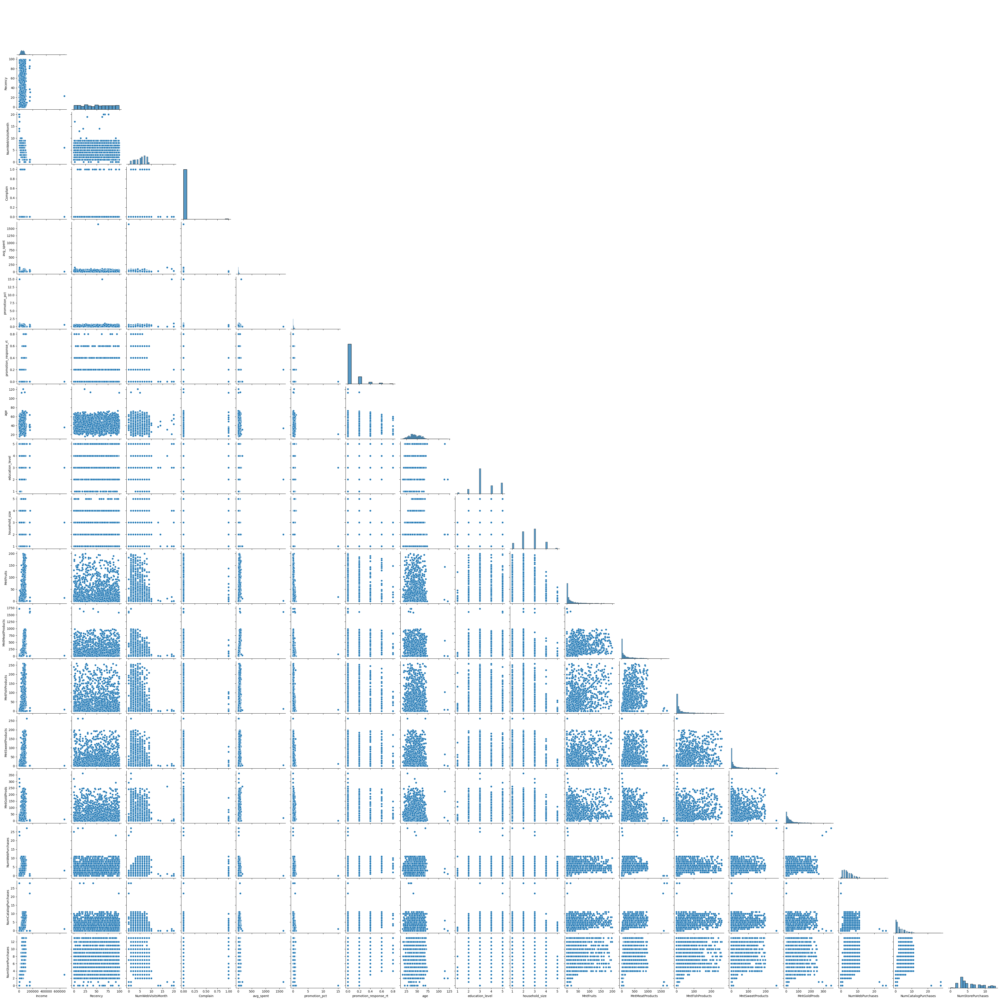

In [21]:
print(sns.pairplot(df, corner=True))

#### Missing Values  
Though it is a small view, you can clearly see outliers throughout the dataset. Almost every feature has at least one outlier. For example, The age column (column 8) has several individuals who are over 115. Before we can deal with outliers, we need to deal with missing values. This step comes before because almost all techniques for handling outliers requires analysis of the other values in the column.

This line retrieves fields with missing values. 

In [22]:
df[df.isnull().any(axis=1) | np.isinf(df).any(axis=1)]

,Income,Recency,NumWebVisitsMonth,Complain,avg_spent,promotion_pct,promotion_response_rt,age,education_level,household_size,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases
10,NaN,11,7,0,4.666667,0.333333,0.0,30,3,3,5,6,0,2,1,1,0,2
27,NaN,19,1,0,23.407407,0.000000,0.0,27,3,2,1,3,3,263,362,27,0,0
43,NaN,80,2,0,13.125000,0.125000,0.0,54,5,1,11,50,3,2,39,1,3,4
48,NaN,96,6,0,10.857143,0.428571,0.0,63,3,4,5,48,6,10,7,2,1,4
58,NaN,57,6,0,7.000000,0.400000,0.0,31,3,2,3,22,2,2,6,2,0,3
71,NaN,25,8,0,14.000000,0.500000,0.0,39,2,3,3,43,17,4,17,3,0,3
90,NaN,4,9,0,21.941176,0.705882,0.0,55,5,5,42,192,49,37,53,7,2,8
91,NaN,45,7,0,3.666667,0.333333,0.0,57,3,3,0,8,2,0,1,1,0,2
92,NaN,87,1,0,38.571429,0.071429,0.0,40,4,2,37,359,98,28,18,2,4,8
128,NaN,23,6,0,3.714286,0.214286,0.0,52,5,3,0,27,10,0,15,6,1,7


I am electing to remove these fields. There are a few reasons for this, but they all boil down to preference. I prefer to remove missing values because I find all other methods problematic. For example, a common practice is to replace missing values with the mean for the column. Statistically, this makes the data point disappear (almost). However, there are several problems with this approach. First, it is not true and I prefer to deal with the truth. Second, when clustering, a large number of missing values placed at the mean could induce new clusters of customers because the other customer data point inidcate a non-average consumer who happens to be at the average on this particular field. Third, the data set is large enough that removing even 200 problematic records still leaves us with a sample of more than 2000 customers. 

So, I use the following line to replace all problematic values (dividing by zero produces inf values) with missing values.

In [23]:
df = df.replace([np.inf, -np.inf], np.nan)

And then I drop those fields.

In [24]:
df = df.dropna()

#### Outliers
Outliers are dealt with in a similar way. Some prefer to replace the outlier with the mean of the column. Others may opt for something less drastic like replacing the outlier with the middle value of an exteme quartile thus leaving the value in a similar zone but closer to the overall distribution.

I just like to get rid of them. The following line creates a mask which selects all values greater than 3.5 standard deviations from the mean. Statistically, this would leave >99% of our values untouched but would remove the more extreme values.

In [25]:
mask = df[df.columns.difference(['Complain', 'promotion_response_rt'])].sub(df.mean()).div(df.std()).gt(3.5)

I then apply the mask and set those values to missing values.

In [26]:
df = df.mask(mask)

This line highlights the fields that previously had missing values and now have missing values. It is always best to take a look at these values before removing them. 

In [27]:
df[df.isnull().any(axis=1) | np.isinf(df).any(axis=1)]

,Income,Recency,NumWebVisitsMonth,Complain,avg_spent,promotion_pct,promotion_response_rt,age,education_level,household_size,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumWebPurchases,NumCatalogPurchases,NumStorePurchases
9,5648.0,68,NaN,0,21.000000,1.000000,0.2,64.0,5,4,0.0,6.0,1.0,1.0,13.0,1.0,0.0,0
21,2447.0,42,1.0,0,61.750000,0.535714,0.0,34.0,3,3,1.0,NaN,1.0,1.0,1.0,0.0,NaN,0
40,80011.0,3,4.0,0,51.263158,0.105263,0.0,33.0,3,3,76.0,536.0,82.0,NaN,102.0,8.0,6.0,5
53,82582.0,54,1.0,0,55.350000,0.050000,0.4,37.0,3,1,120.0,550.0,156.0,40.0,NaN,4.0,9.0,7
102,85693.0,59,5.0,0,31.320000,0.080000,0.0,34.0,3,3,NaN,183.0,185.0,132.0,111.0,9.0,5.0,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2173,71965.0,21,3.0,0,45.785714,0.214286,0.0,62.0,3,3,19.0,286.0,50.0,38.0,NaN,6.0,3.0,5
2178,52914.0,32,7.0,0,24.692308,0.153846,0.2,42.0,3,3,10.0,44.0,30.0,10.0,NaN,7.0,3.0,3
2217,82032.0,54,1.0,0,53.058824,0.000000,0.0,66.0,5,1,NaN,377.0,149.0,125.0,57.0,4.0,6.0,7
2233,NaN,23,6.0,0,7.571429,0.571429,0.0,36.0,3,3,14.0,18.0,8.0,1.0,12.0,3.0,1.0,3


Finally, I remove the new missing values.

In [28]:
df = df.dropna()

### Model Specification
#### Preprocessing
As with the previous exercises, we will create some standard transformers to handle different kinds of data. Categorical variables must be transformed into number, count data must be log-transformed and scaled, and numeric data must be scaled. These pipelines ensure consistency. We may not always need all pipelines, but we will always want to handle these datatypes in a consistent way. 

In [29]:
# Define the pipeline
count_transformer = Pipeline(steps=[
    ('log', FunctionTransformer(np.log1p)),
    ('scaler', StandardScaler())
])

In [30]:
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

In [31]:
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

#### Model Selection
My preprocess only needs to handle numeric values because I transformed all categorical values into number and I've opted to treat all count values as numbers.

In [32]:
preprocessor = ColumnTransformer(
    transformers=[
        ('cont', numeric_transformer, numeric_cols),
    ])

##### KMeans Clustering
In the following lines, I create a KMeans base model and build a pipeline that transforms the features before feeding them into the algorithm. 

In [33]:
base_model = KMeans(random_state=42)   # KMeans clustering

pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', base_model)
])

The KMeans clustering algorithm requires us to provide a number of clusters. We don't know how many clusters to define so we could guess or we could systematically try a variety of numbers of clusters to see how clustering peforms for each number of clusters. The following line calls a fuction I built which tests the model at a variety of numbers of clusters and reports the optimal number of clusters for our data.

{'n_clusters': {'silhouette': 2, 'calinski_harabasz': 2, 'davies_bouldin': 2}}

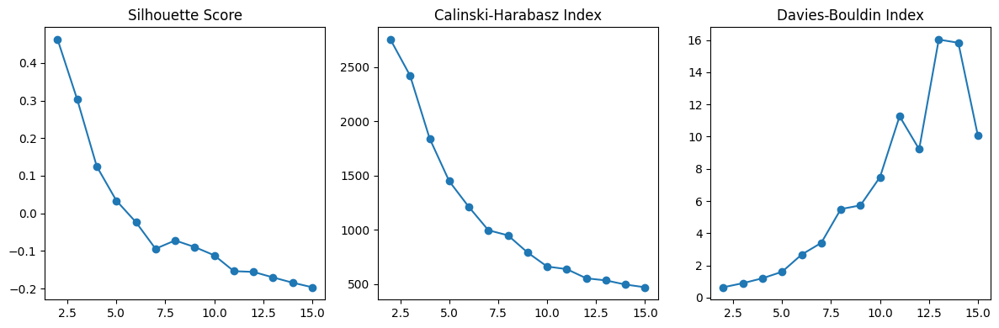

In [34]:
find_optimal_clusters(pipeline, df[numeric_cols])

The various metrics (Silhouette, Calinski-Harabasz, and Davies-Boulin) all assess cluster quality in various ways. The Silhouette score measures how similar an object is to its own cluster compared to other clusters, ranging from -1 to 1. A higher value indicates better-defined clusters. The Calinski-Harabasz score, evaluates the ratio of the sum of between-cluster dispersion to within-cluster dispersion. Higher values signify well-separated clusters. Lastly, the Davies-Bouldin score measures the average similarity ratio of each cluster with its most similar cluster, where lower values indicate better clustering quality. These scores together offer insights into the compactness and separation of clusters, aiding in the selection of an optimal clustering algorithm.

All three metrics seem to agree that our data have 2 clusters so we're going to run the KMeans model with two clusters.

In [35]:
pipeline['model'].n_clusters = 2

The clustering algorithms predict 'labels' which are indicative of the cluster to which each record belongs.

In [36]:
labels = pipeline.fit_predict(df[numeric_cols])

We will add the labels to our dataframe so that we can take a look at the results and compare them to other clustering methods.

In [37]:
df['kmeans_cluster'] = labels

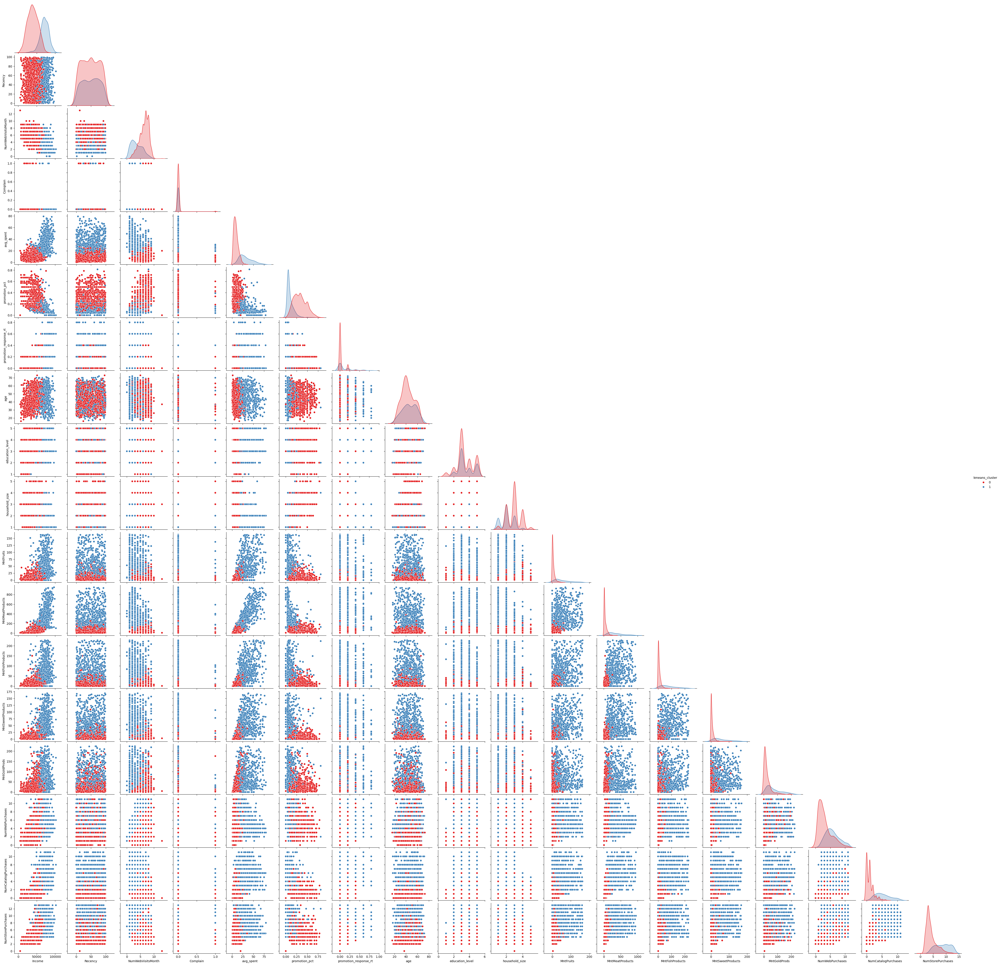

In [38]:
print(sns.pairplot(df[numeric_cols + ['kmeans_cluster']], hue='kmeans_cluster', corner=True, palette="Set1"))

##### Agglomerative Clustering
In the following lines, I create an Agglomerative base model and build a pipeline that transforms the features before feeding them into the algorithm. 

In [39]:
base_model = AgglomerativeClustering()

pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', base_model)
])

Again we will find the optimal number of clusters.

{'n_clusters': {'silhouette': 2, 'calinski_harabasz': 3, 'davies_bouldin': 2}}

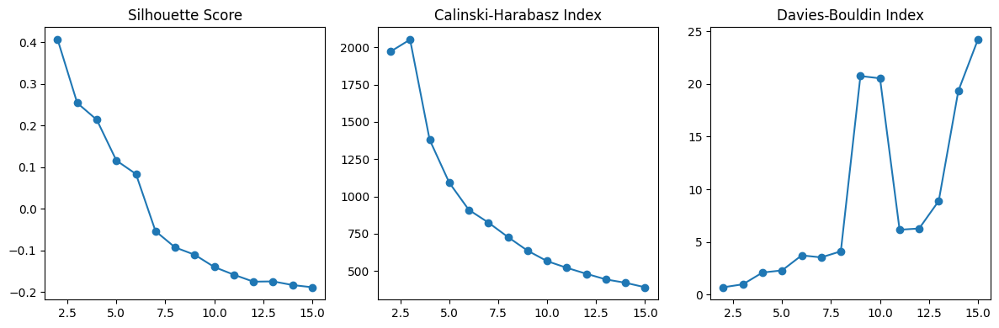

In [40]:
find_optimal_clusters(pipeline, df[numeric_cols])

Here the metrics are inconsistent with two metrics opting for 2 clusters and 1 opting for 3 clusters. For variety, we will try a 3 cluster approach.

In [41]:
pipeline['model'].n_clusters = 3

Again, we predict the labels.

In [42]:
labels = pipeline.fit_predict(df[numeric_cols])

And save them to our dataframe.

In [43]:
df['agglomerative_cluster'] = labels

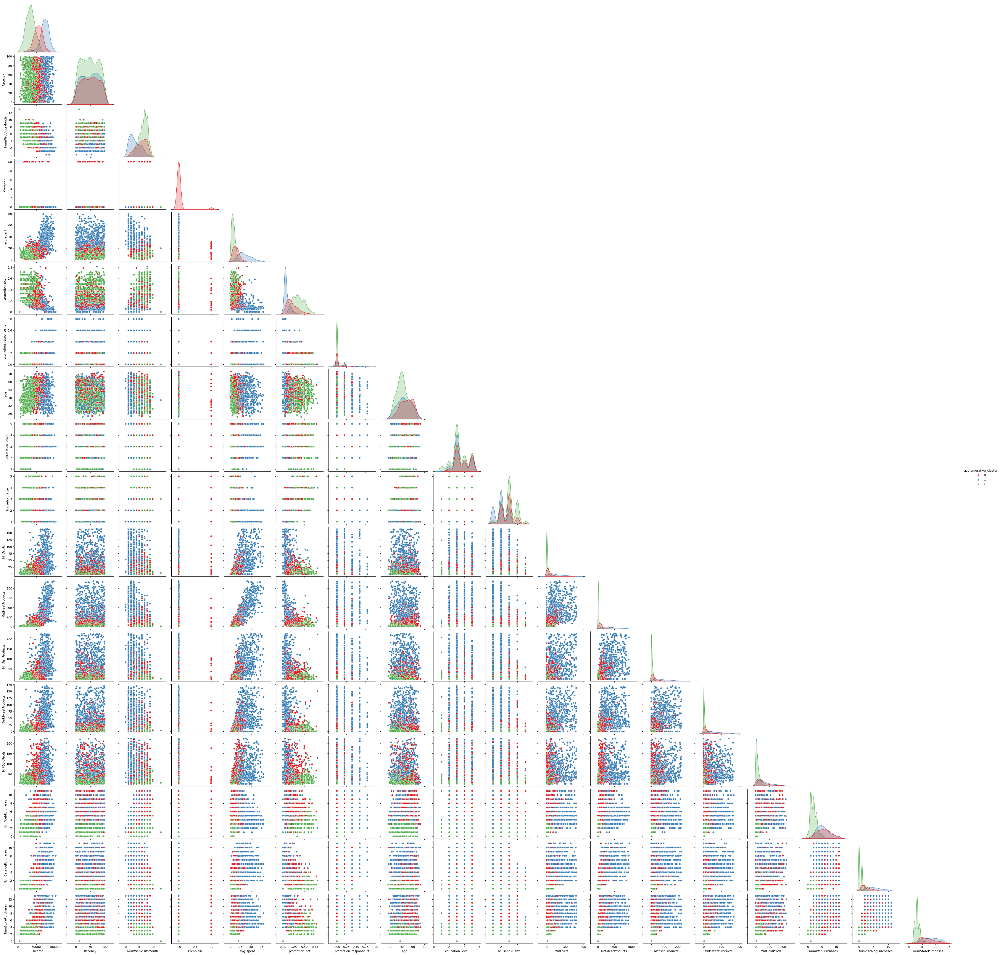

In [44]:
print(sns.pairplot(df[numeric_cols + ['agglomerative_cluster']], hue='agglomerative_cluster', corner=True, palette="Set1"))

##### DBScan Clustering
In the following lines, I create an Agglomerative base model and build a pipeline that transforms the features before feeding them into the algorithm. 

In [45]:
base_model = DBSCAN()

pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', base_model)
])

The DBScan algorithm uses *epsilon* to predict clusters based on the density of the datapoints. So, we we search for optimal clusters, the function will run the model with various values of epsilon and report the best performing value.

{'eps': {'silhouette': 2.25,
  'calinski_harabasz': 2.25,
  'davies_bouldin': 2.25}}

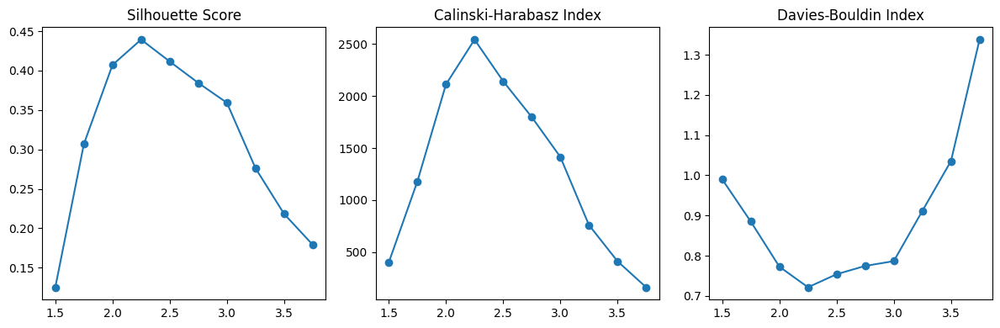

In [46]:
find_optimal_clusters(pipeline, df[numeric_cols])

Here, an epison of 2.25 seems to proivde the best clustering performance so we'll set eps to 2.25. The DBScan algorithm also requires a min_samples hyperparameter that can affect model performance. Rather than testing various levels of min_samples, it is easiest to start with a min_samples value that is twice the number of features in your model. 

In [47]:
pipeline['model'].eps = 2.25
pipeline['model'].min_samples = 2 * len(numeric_cols)

Again, we fit the model and predict the labels.

In [48]:
labels = pipeline.fit_predict(df[numeric_cols])

Again, we add the labels to our dataframe for later comparison.

In [49]:
df['dbscan_cluster'] = labels

We have no way of knowing how many clusters the DBScan algorithm produces so I'm going to summarize the counts in each cluster.

In [50]:
df['dbscan_cluster'].value_counts()

dbscan_cluster
 0    1124
-1     968
Name: count, dtype: int64

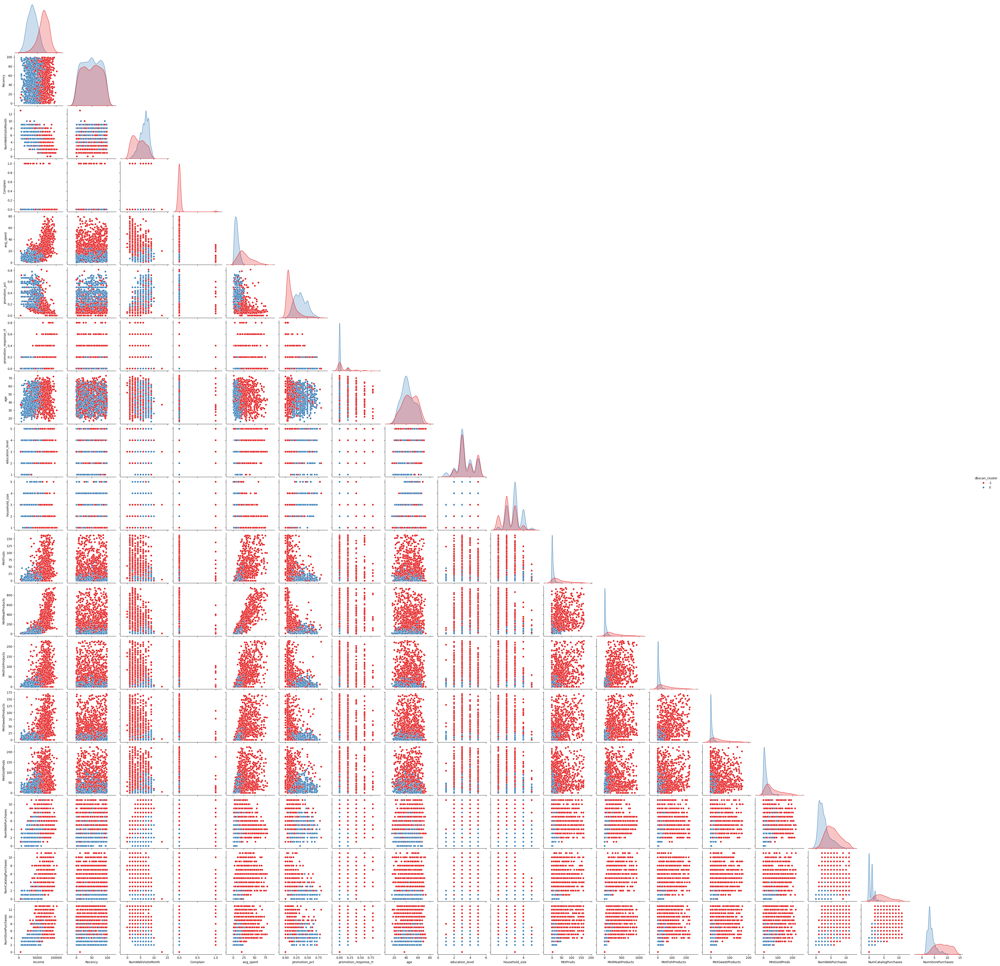

In [51]:
print(sns.pairplot(df[numeric_cols + ['dbscan_cluster']], hue='dbscan_cluster', corner=True, palette="Set1"))

### Model Evaluation

Silhouette Score: 0.46206302864717813
Calinski-Harabasz Score: 2755.3682022722637
Davies-Bouldin Score: 0.6497917743105297


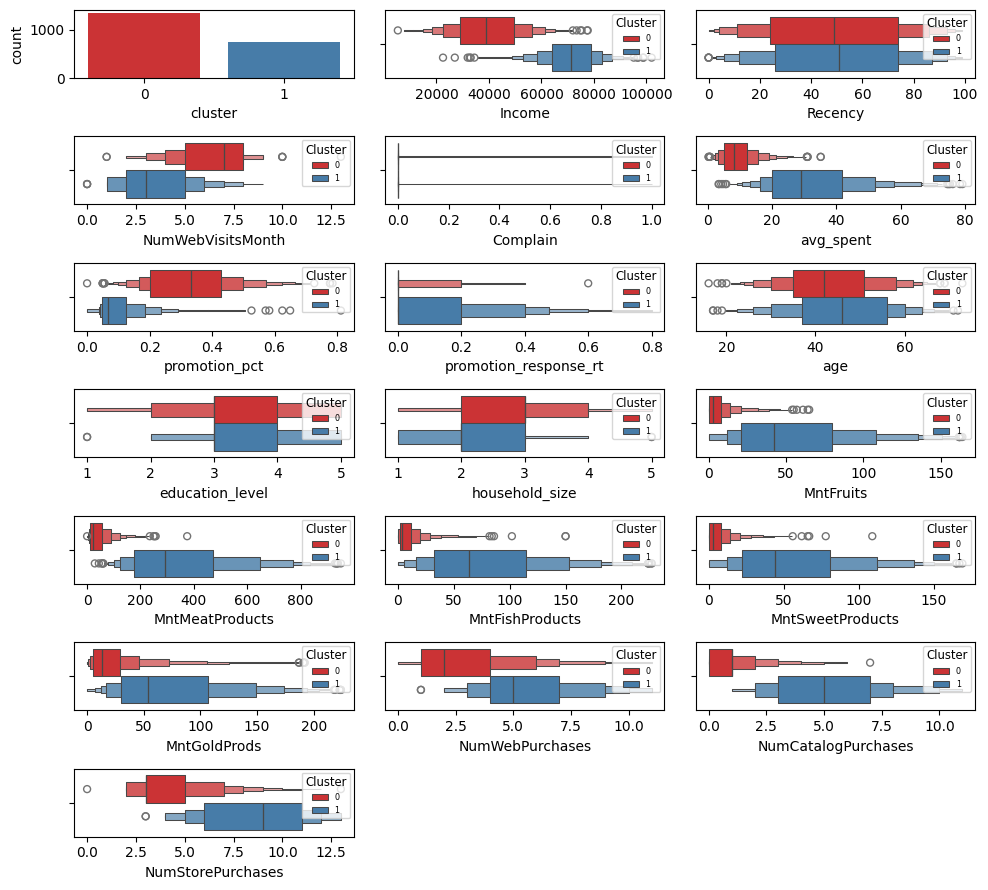

In [52]:
cluster_preformance(df[numeric_cols], df['kmeans_cluster'])

Silhouette Score: 0.25468661681699845
Calinski-Harabasz Score: 2052.39382677459
Davies-Bouldin Score: 0.9881394101866876


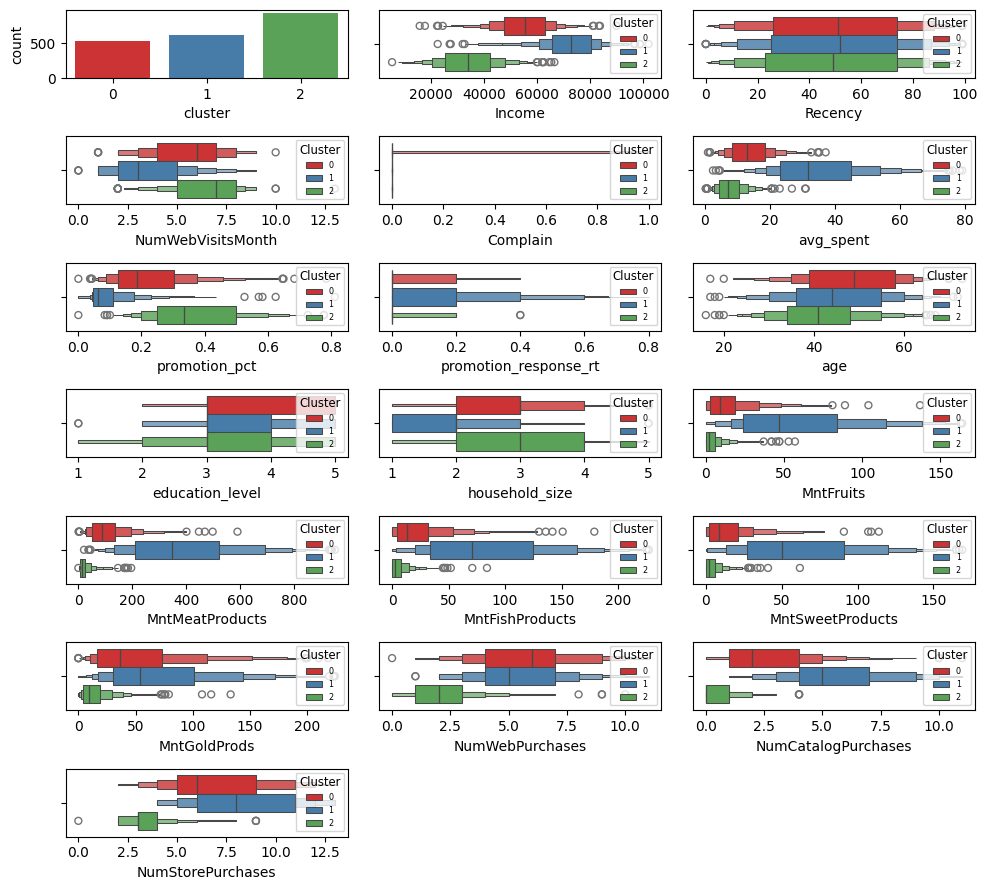

In [53]:
cluster_preformance(df[numeric_cols], df['agglomerative_cluster'])

Silhouette Score: 0.4393183797773401
Calinski-Harabasz Score: 2541.886582756573
Davies-Bouldin Score: 0.7214808233030665


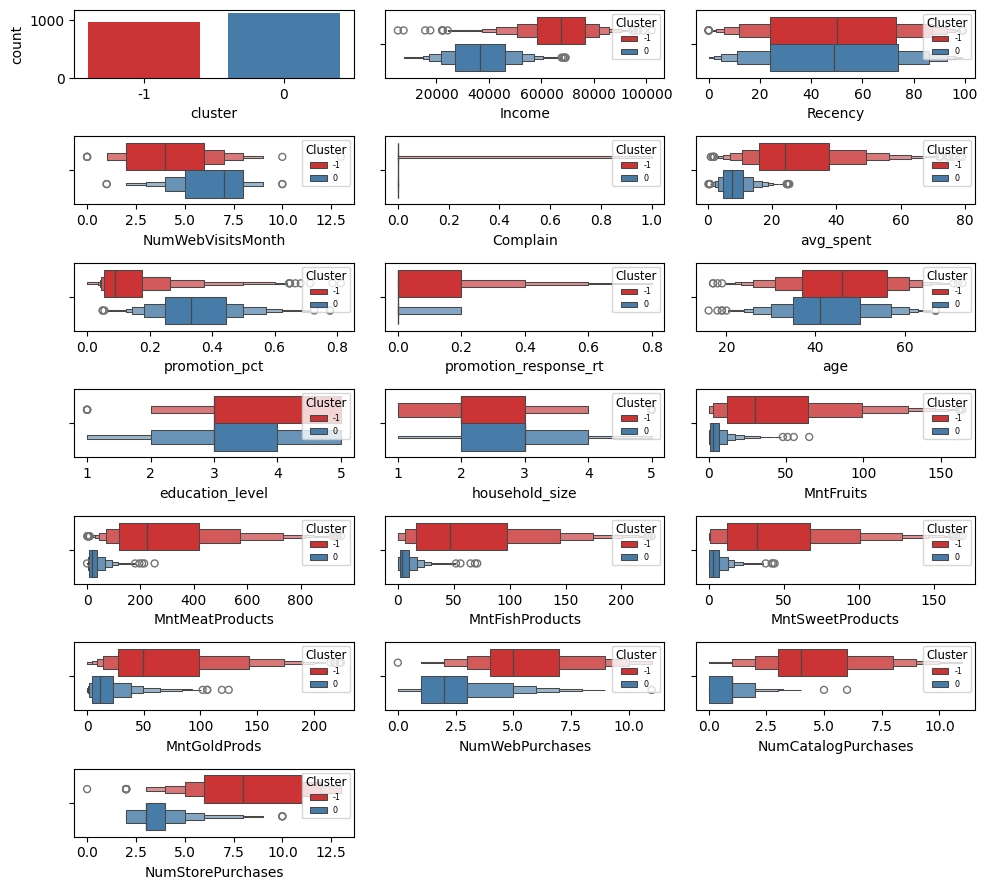

In [54]:
cluster_preformance(df[numeric_cols], df['dbscan_cluster'])

#### Dimensionality Reduction
With a large number of features, overfitting becomes a problem. A common way of dealing with feature propogation is to cluster the features in much the same way we try to cluster records. This effectively redueces the total number of features by grouping like features together in a single feature.

As with clustering, it is not clear exactly what the optimal number of features may be. The following function iterates through a variety of feature structures and reports metrics which will help us make an informed decion.

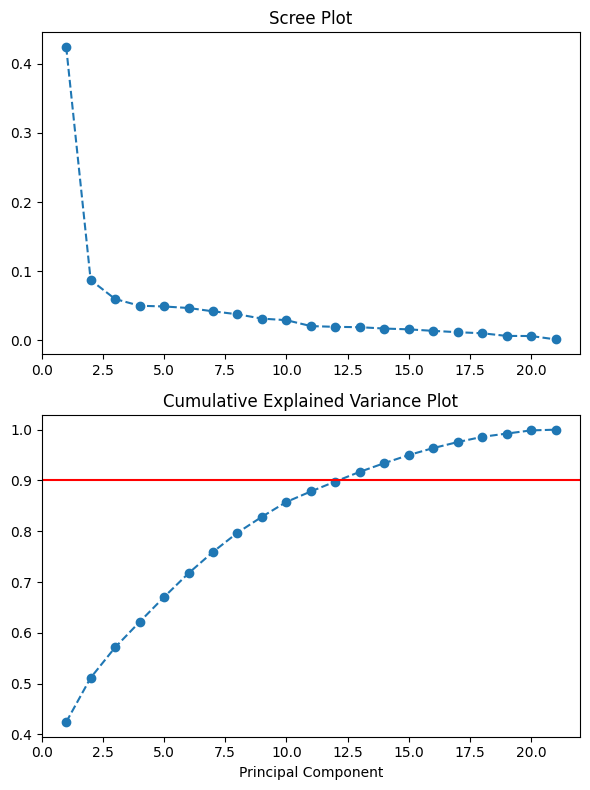

In [55]:
find_optimal_dimensions(df[numeric_cols])

A scree plot displays the eigenvalues associated with each principal component, often in descending order. By examining the plot, one can identify the "elbow" point where the curve starts to flatten, indicating that additional components contribute less to the overall variance and may be less meaningful. The cumulative variance plot, on the other hand, shows the cumulative percentage of total variance explained by the principal components. By interpreting this plot, you can determine the number of components needed to capture a desired amount of variance. Typically, you'll look for the point where the cumulative variance reaches an acceptable threshold, such as 90%, to decide how many principal components to retain for further analysis. These plots help in reducing dimensionality while preserving the most critical information from the dataset.

To incorporate this information, we will add a Principal Components Analysis step to our modeling pipeline. We will start with a value of 4 which explains 65% of the variance and seems to be the point after which little additional variance is explained by subsequent components. This is subjective.

In [56]:
dr = PCA(n_components=4)

Now we set our base model and build the pipeline.

In [57]:
base_model = KMeans(random_state=42)   # KMeans clustering

pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('dr', dr),
    ('model', base_model)
])

Again, we will find the optimal number of clusters.

{'n_clusters': {'silhouette': 2, 'calinski_harabasz': 2, 'davies_bouldin': 2}}

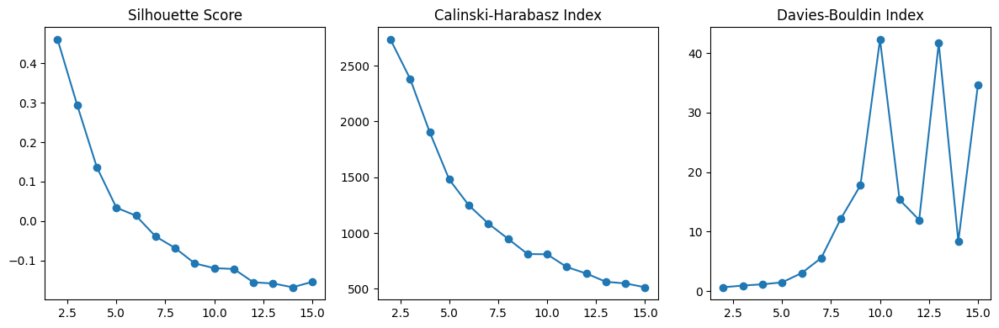

In [58]:
find_optimal_clusters(pipeline, df[numeric_cols])

And we will set the number of clusters to 2

In [59]:
pipeline['model'].n_clusters = 2

Using those parameters, we will fit our model and predict the labels.

In [60]:
labels = pipeline.fit_predict(df[numeric_cols])

Finally, we add the labels to our dataframe.

In [61]:
df['kmeans_cluster_dr'] = labels

With the new labels applied, we can assess the performance of our model with fewer features.

Silhouette Score: 0.460631137847148
Calinski-Harabasz Score: 2734.888496607931
Davies-Bouldin Score: 0.6505457385982357


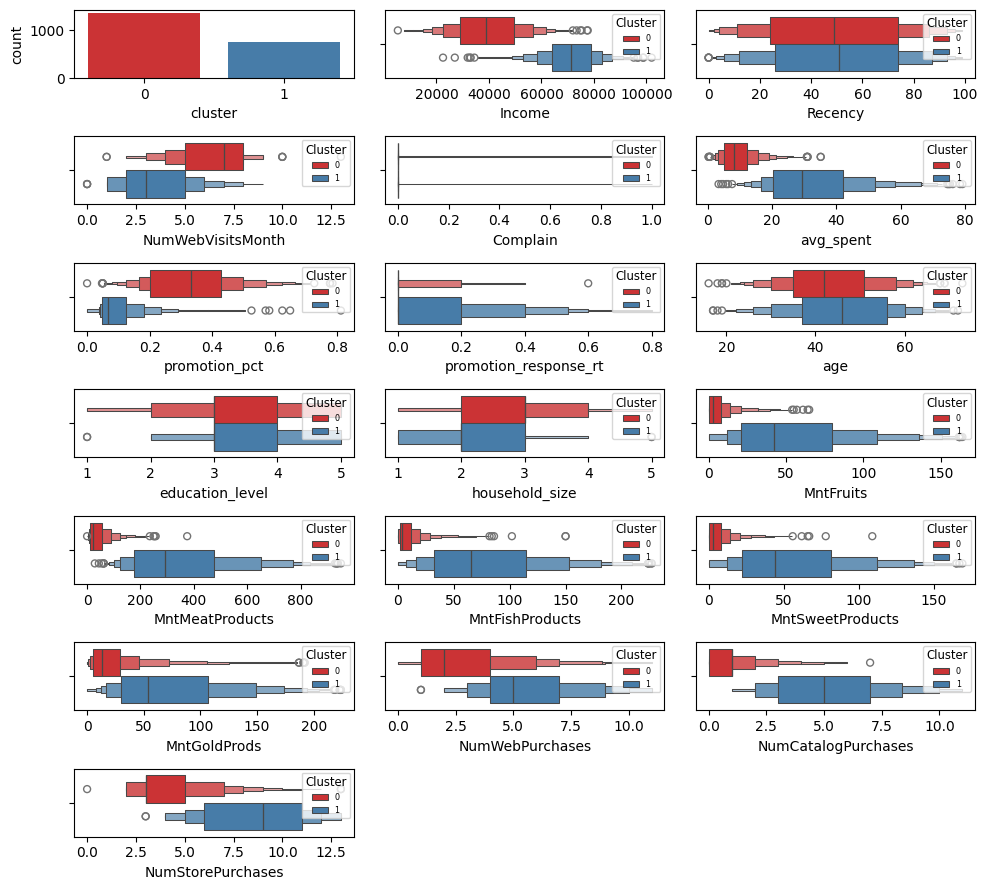

In [62]:
cluster_preformance(df[numeric_cols], df['kmeans_cluster_dr'])

This approach reduces the number of features from 18 to 4 and maintains the same level of clustering performance. This means that our clustering results are far more likely to be generalizable and the model requires far less computing power.

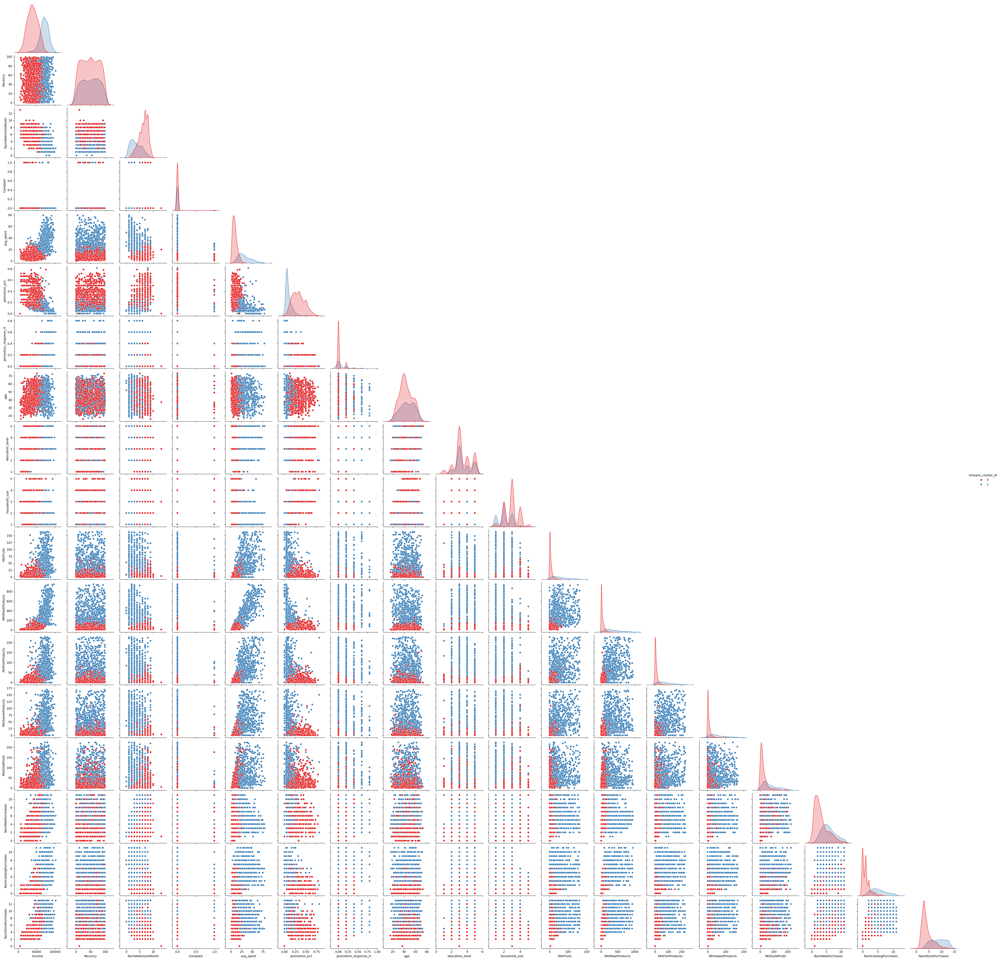

In [63]:
print(sns.pairplot(df[numeric_cols + ['kmeans_cluster_dr']], hue='kmeans_cluster_dr', corner=True, palette="Set1"))

### Conclusion
The resutls of our clustering produces a 2-cluster solution. The results are good, but given the size of our sample and the nature of our data, a 2-cluster result is a little disappointing because it does not provide much insight about our customers. Instead, the analyses produced heavy-user/light-user clusters that one would expect to find in almost every retail location. It does not appear that there are different types of heavy-users nor does it appear that there are different types of light-users. This is a little surprising but it may be an artificact of the shopping categories we have at our disposal. It is possible the more shopping data would give us more insight into niche groups within our sample. Alternatively, we could build a new dataset by splitting our sample on some interesting column to look for emergant subgroups. For example, we could split the sample into groups of high vs. low web visists per month because it is likely easier to target online shoppers than it might be to target catelog or in-store customers. Then, we could look for clusters of shoppers in the high-web visits sample to see if there are any niche groups we could target with specialized promotion campaigns.

## Clustering Exercise 2
### Business Problem

### Data Collection

### Data Profiling

### Model Specification

### Model Evaluation

### Conclusion